<a href="https://colab.research.google.com/github/Jagritimaurya82/Background-Subtraction/blob/main/saree_segmentation_new.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


# Loading data

we will use **saree images** as dataset. It is a set of:
 - **train** images + segmentation masks
 - **validation** images + segmentation masks
 - **test** images + segmentation masks
 
All images have 320 pixels height and 480 pixels width.

In [ ]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'    # specify which GPU(s) to be used. It only uses GPU no. 0 .
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [ ]:
DATA_DIR = '/content/gdrive/MyDrive/background_subtraction_saree/Data_Saree_323'

In [ ]:
x_train_dir = os.path.join(DATA_DIR, 'train')
y_train_dir = os.path.join(DATA_DIR, 'train_mask')

x_valid_dir = os.path.join(DATA_DIR, 'val')
y_valid_dir = os.path.join(DATA_DIR, 'val_mask')

x_test_dir = os.path.join(DATA_DIR, 'test')
y_test_dir = os.path.join(DATA_DIR, 'test_mask')

In [ ]:
# helper function for data visualization
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

### Dataloader

Writing helper class for data extraction, tranformation and preprocessing  
https://pytorch.org/docs/stable/data

In [ ]:
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset

In [ ]:
class Dataset(BaseDataset):
    """ Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    CLASSES = ['mask']
    
    def __init__(self, images_dir, masks_dir, classes=None, augmentation=None, preprocessing=None,):
        
        self.ids = os.listdir(images_dir)
        self.images_fps = [os.path.join(images_dir, image_id) for image_id in self.ids]
        self.masks_fps = [os.path.join(masks_dir, image_id) for image_id in self.ids]
        
        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i])
         
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.masks_fps[i], 0)
        
        # extract certain classes from mask (e.g. mask)
        masks = [(mask == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        return len(self.ids)

In [ ]:
class Dataset_test(BaseDataset):
    """ Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    CLASSES = ['mask']
    
    def __init__(self, images_dir, masks_dir, classes=None, augmentation=None, preprocessing=None,):
        
        self.ids = os.listdir(images_dir)
        self.images_fps = [os.path.join(images_dir, image_id) for image_id in self.ids]
        self.masks_fps = [os.path.join(masks_dir, image_id) for image_id in self.ids]
        
        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i])
        image = cv2.resize(image,(320,480))
        # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)               
        mask = cv2.imread(self.masks_fps[i], 0)
        
        # extract certain classes from mask (e.g. mask)
        masks = [(mask == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask, self.images_fps[i]                                              #
        
    def __len__(self):
        return len(self.ids)

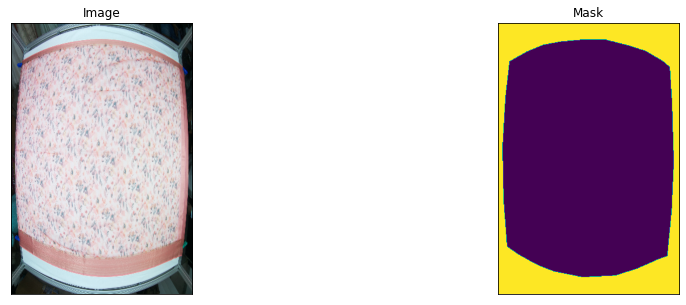

In [ ]:
# Lets look at data we have

dataset = Dataset(x_train_dir, y_train_dir, classes=['mask'])

image, mask = dataset[70] # get some sample
visualize(image=image, mask=mask.squeeze(),)
 

### Augmentations

Data augmentation is a powerful technique to increase the amount of your data and prevent model overfitting.  
If you not familiar with such trick read some of these articles:
 - [The Effectiveness of Data Augmentation in Image Classification using Deep
Learning](http://cs231n.stanford.edu/reports/2017/pdfs/300.pdf)
 - [Data Augmentation | How to use Deep Learning when you have Limited Data](https://medium.com/nanonets/how-to-use-deep-learning-when-you-have-limited-data-part-2-data-augmentation-c26971dc8ced)
 - [Data Augmentation Experimentation](https://towardsdatascience.com/data-augmentation-experimentation-3e274504f04b)

Since our dataset is very small we will apply a large number of different augmentations:
 - horizontal flip
 - affine transforms
 - perspective transforms
 - brightness/contrast/colors manipulations
 - image bluring and sharpening
 - gaussian noise
 - random crops

All this transforms can be easily applied with [**Albumentations**](https://github.com/albu/albumentations/) - fast augmentation library.
For detailed explanation of image transformations you can look at [kaggle salt segmentation exmaple](https://github.com/albu/albumentations/blob/master/notebooks/example_kaggle_salt.ipynb) provided by [**Albumentations**](https://github.com/albu/albumentations/) authors.

In [ ]:
import albumentations as albu

In [ ]:
def get_training_augmentation():
    train_transform = [

        #albu.HorizontalFlip(p=0.5),

        #albu.ShiftScaleRotate(scale_limit=0.5, rotate_limit=0, shift_limit=0.1, p=1, border_mode=0),

        albu.PadIfNeeded(min_height=320, min_width=320, always_apply=True, border_mode=0),
        
        #albu.RandomCrop(height=320, width=320, always_apply=True),

        albu.IAAAdditiveGaussianNoise(p=0.2),
        
        #albu.IAAPerspective(p=0.5),

        albu.OneOf(
            [
                albu.CLAHE(p=1),
                albu.RandomBrightness(p=1),
                albu.RandomGamma(p=1),
            ],
            p=0.9,
        ),

        albu.OneOf(
            [
                albu.IAASharpen(p=1),
                albu.Blur(blur_limit=3, p=1),
                albu.MotionBlur(blur_limit=3, p=1),
            ],
            p=0.9,
        ),

        albu.OneOf(
            [
                albu.RandomContrast(p=1),
                albu.HueSaturationValue(p=1),
            ],
            p=0.9,
        ),
    ]
    return albu.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        albu.PadIfNeeded(384, 320)   
    ]
    return albu.Compose(test_transform)


def to_tensor(x, **kwargs): 
    return x.transpose(2, 0, 1).astype('float32')
     


def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform
    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    
    """
    
    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

(480, 320, 3)


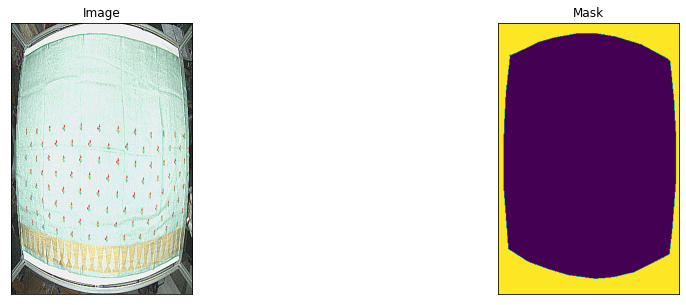

In [ ]:
#### Visualize resulted augmented images and masks

augmented_dataset = Dataset(x_train_dir, y_train_dir, augmentation=get_training_augmentation(), classes=['mask'],)

# same image with different random transforms
for i in range(1):
    image, mask = augmented_dataset[i]
    print(image.shape)
    visualize(image=image, mask=mask.squeeze(-1))

## Create model and train

In [ ]:
pip install -U git+https://github.com/qubvel/segmentation_models.pytorch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/qubvel/segmentation_models.pytorch to /tmp/pip-req-build-6cbe5lhs
  Running command git clone -q https://github.com/qubvel/segmentation_models.pytorch /tmp/pip-req-build-6cbe5lhs
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 376 kB 34.0 MB/s 
     |████████████████████████████████| 58 kB 4.4 MB/s 
  Created wheel for segmentation-models-pytorch: filename=segmentation_models_pytorch-0.3.0-py3-none-any.whl size=102076 sha256=f3acfdead40e4c7703539a63fe62818157f8889411c66e535b904196196d4980
  Stored in directory: /tmp/pip-ephem-wheel-cache-odkorqo5/wheels/fa/c5/a8/1e8af6cb04a0974db8a4a156ebd2fdd1d99ad2558d3fce49d4
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=548cb7f94e5020631b6f8

In [ ]:
import torch
import numpy as np
import segmentation_models_pytorch as smp
from segmentation_models_pytorch import utils

In [ ]:
# ENCODER = 'se_resnext50_32x4d'
ENCODER = 'resnet34'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['mask']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation
DEVICE = 'cuda'
# DEVICE = 'cpu'


# create segmentation model with pretrained encoder
model = smp.FPN(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION,)
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [ ]:
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    augmentation=get_training_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=0)

In [ ]:
# Dice/F1 score - https://en.wikipedia.org/wiki/S%C3%B8rensen%E2%80%93Dice_coefficient
# IoU/Jaccard score - https://en.wikipedia.org/wiki/Jaccard_index

loss = smp.utils.losses.DiceLoss()
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0001),
])

In [ ]:
# create epoch runners 
# it is a simple loop of iterating over dataloader`s samples
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [ ]:
# #train model for 40 epochs
# max_score = 0
# for i in range(0, 40):
    
#     print('\nEpoch: {}'.format(i))
#     train_logs = train_epoch.run(train_loader)
#     valid_logs = valid_epoch.run(valid_loader)
    
#     # do something (save model, change lr, etc.)
#     if max_score < valid_logs['iou_score']:
#         max_score = valid_logs['iou_score']
#         torch.save(model, './saree_best_model_323_epoch.pth')
#         print('Model saved!')
        
#     if i == 25:
#         optimizer.param_groups[0]['lr'] = 1e-5
#         print('Decrease decoder learning rate to 1e-5!')

## Test best saved model

In [ ]:
# load best saved checkpoint
best_model = torch.load(r'/content/gdrive/MyDrive/background_subtraction_saree/saree_323_40_epoch.pth')

In [ ]:
# create test dataset
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

test_dataloader = DataLoader(test_dataset)

In [ ]:
# evaluate model on test set
test_epoch = smp.utils.train.ValidEpoch(
    model=best_model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
)

logs = test_epoch.run(test_dataloader)

valid: 100%|██████████| 1/1 [00:00<00:00, 21.12it/s, dice_loss - 0.01241, iou_score - 0.9762]


## Visualize predictions

In [ ]:
# test dataset without transformations for image visualization
test_dataset_vis = Dataset(x_test_dir, y_test_dir, classes=CLASSES,)

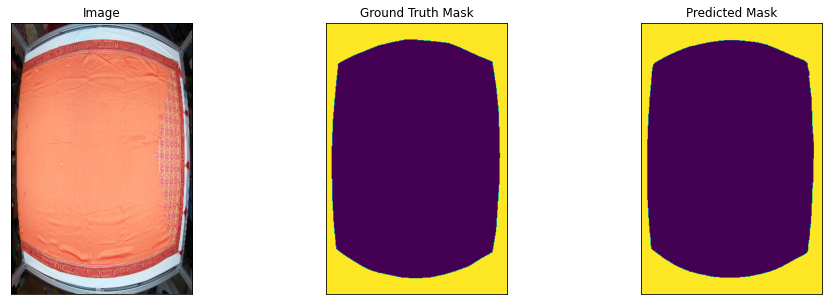

In [ ]:
best_model.eval()
for i in range(1):
    n = np.random.choice(len(test_dataset))
    
    image_vis = test_dataset_vis[n][0].astype('uint8')
    image, gt_mask = test_dataset[n]
    
    gt_mask = gt_mask.squeeze()
    
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    pr_mask = best_model.predict(x_tensor)
    # print(x_tensor.shape)
    # print(x_tensor)
    pr_mask = (pr_mask.squeeze().cpu().numpy().round())
#     print(image.shape)
    # print(pr_mask.shape)
    visualize(
        image=image_vis, 
        ground_truth_mask=gt_mask, 
        predicted_mask=pr_mask
    )


 

# Inference Experimentation 

In [ ]:
x_valid_dir = "/content/gdrive/MyDrive/background_subtraction_saree/Saree_323_org"
y_valid_dir = "/content/gdrive/MyDrive/background_subtraction_saree/Data_Saree_323/train_mask"

valid_dataset = Dataset_test(
    x_valid_dir, 
    y_valid_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    classes=CLASSES,
)

In [ ]:
dataset_vis = Dataset_test(x_valid_dir, y_valid_dir, classes=['mask'])

In [ ]:
best_model.eval()
files = os.listdir(x_valid_dir)
for file in files:
# for i in range(1):
    n = np.random.choice(len(valid_dataset))
    image_vis = dataset_vis[n][0].astype('uint8')
    image, gt_mask, image_name = valid_dataset[n]                                    #
    gt_mask = gt_mask.squeeze()
    # print(image_name)
      # img = cv2.imread(image_name)
      # cv2_imshow(img)

    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    pr_mask = best_model.predict(x_tensor)
    pr_mask = (pr_mask.squeeze().cpu().numpy().round())
    # image = image.transpose((1, 2, 0))
      
    cv2.imwrite("pr.png",pr_mask)
    pr_mask = cv2.imread(r"/content/pr.png")
    pr_mask=pr_mask*255
    not_mask = cv2.bitwise_not(pr_mask)
    not_mask = not_mask/255

    output = image_vis*not_mask
    cv2.imwrite("output.png",output)

    src = cv2.imread(r"/content/output.png")
    tmp = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)
    _, alpha = cv2.threshold(tmp, 0, 255, cv2.THRESH_BINARY)
    b, g, r = cv2.split(src)
    rgba = [b, g, r, alpha]
    dst = cv2.merge(rgba, 4)
      # cv2_imshow(dst)
      # cv2.imwrite("dst.png",dst)
      # print(dst.shape)
    img = image_name.split("/")[6]
    # print(img)

    output_path = r"/content/gdrive/MyDrive/background_subtraction_saree/Output_2"           #
    cv2.imwrite(os.path.join(output_path,img),dst)                                      #
    
      

In [ ]:
path = r"/content/gdrive/MyDrive/background_subtraction_saree/Output_2"
file = os.listdir(path)
len(file)

303

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

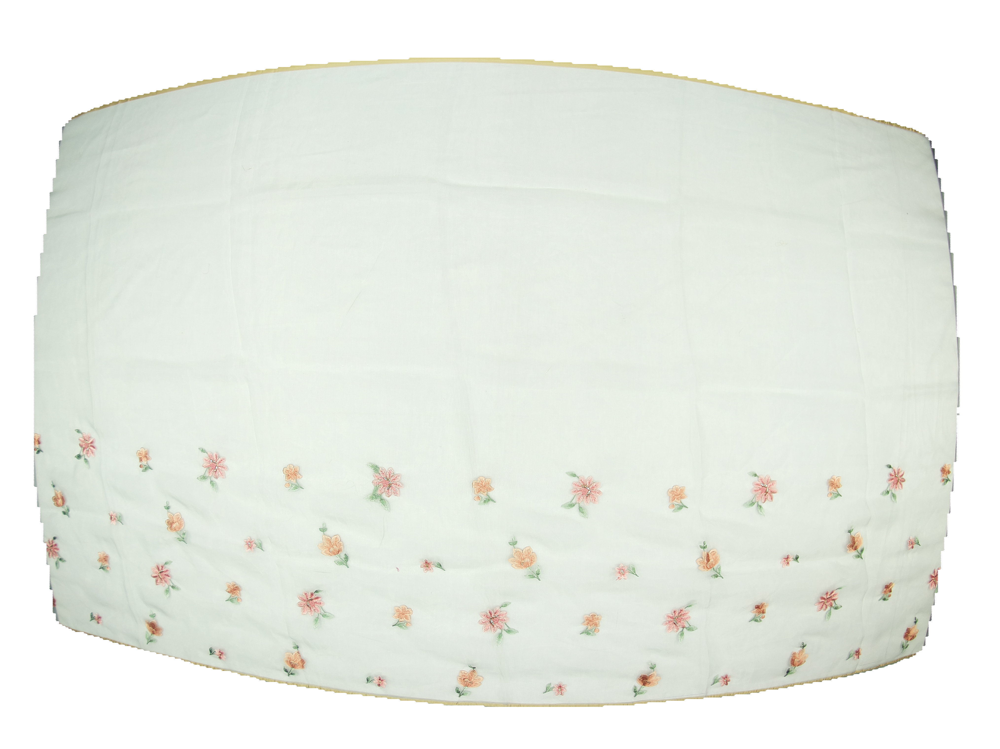

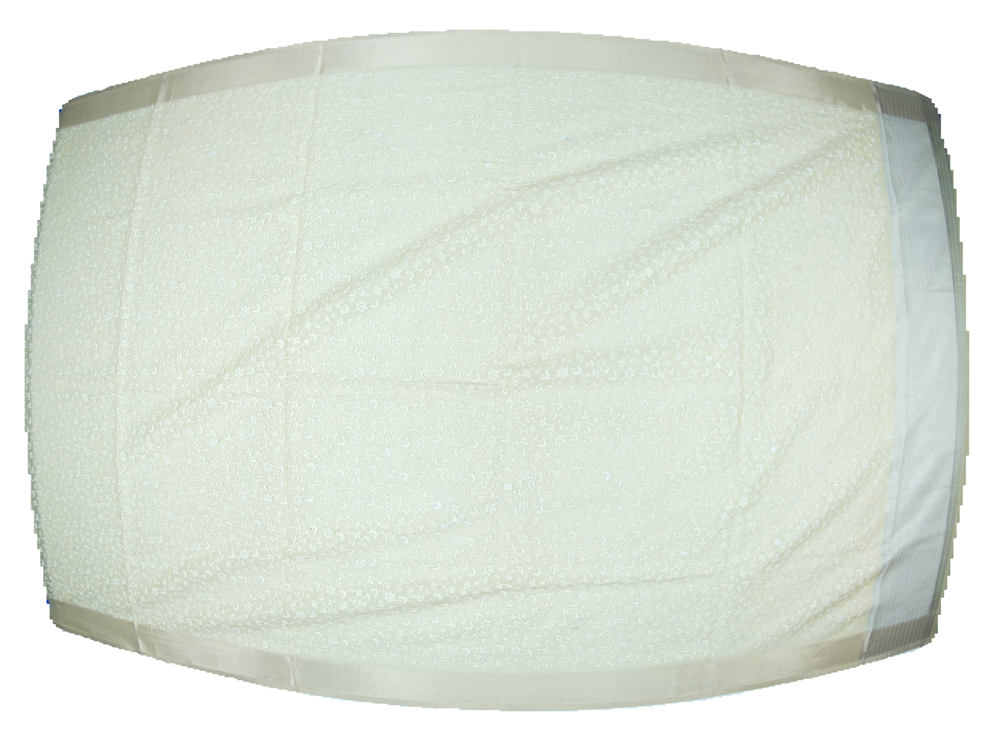

Buffered data was truncated after reaching the output size limit.

In [ ]:
# background subtraction on original size data
best_model.eval()
files = os.listdir(x_valid_dir)
for file in files:
# for i in range(1):

    n = np.random.choice(len(valid_dataset))
    image_vis = dataset_vis[n][0].astype('uint8')
    image, gt_mask, image_name = valid_dataset[n]                                    #
    gt_mask = gt_mask.squeeze()
    img = image_name.split("/")[6]
    # print(image_name)
      # img = cv2.imread(image_name)
      # cv2_imshow(img)

    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    pr_mask = best_model.predict(x_tensor)
    pr_mask = (pr_mask.squeeze().cpu().numpy().round())
    # image = image.transpose((1, 2, 0))
      
    cv2.imwrite("pr.png",pr_mask)
    pr_mask = cv2.imread(r"/content/pr.png")

    pr_mask = cv2.resize(pr_mask,(4056,3040))
    pr_mask=pr_mask*255
    not_mask = cv2.bitwise_not(pr_mask)
    not_mask = not_mask/255

    

    img_path = os.path.join(x_valid_dir,img)
    img_org = cv2.imread(img_path)

    output = img_org*not_mask
    cv2.imwrite("output.png",output)

    # print(not_mask.dtype)
    # print(img_org.dtype)

    src = cv2.imread(r"/content/output.png")
    tmp = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)
    _, alpha = cv2.threshold(tmp, 0, 255, cv2.THRESH_BINARY)
    b, g, r = cv2.split(src)
    rgba = [b, g, r, alpha]
    dst = cv2.merge(rgba, 4)
    cv2_imshow(dst)
      # cv2.imwrite("dst.png",dst)
      # print(dst.shape)
    
    # print(img)

    # output_path = r"/content/gdrive/MyDrive/background_subtraction_saree/Output_3"           #
    # cv2.imwrite(os.path.join(output_path,img),dst)                                      #
    

In [ ]:
from tkinter import VERTICAL
import cv2
import numpy as np
from PIL import Image

# for pallu
img_1 = cv2.imread('43161221_1.png')
img_2 = cv2.imread('30161221_1.png')      
img_2_resized = cv2.resize(img_2,(0,0), fx=1.255, fy=.68)
x_offset = 35
y_offset = 2579
x_end = x_offset + img_2_resized.shape[1]
y_end = y_offset + img_2_resized.shape[0]
img_1[y_offset:y_end,x_offset:x_end] = img_2_resized
cv2.imwrite('r1.png', img_1)
 
# # for repeat 1 part
img_1 = cv2.imread('r1.png')
img_2 = cv2.imread('43161221_1.png')
rotated_image2 = img_2.transpose(Image.ROTATE_90)
img_2_resized = cv2.resize(img_2,(0,0), fx=.68, fy=.751)
x_offset = 35
y_offset = 109
x_end = x_offset + img_2_resized.shape[1]
y_end = y_offset + img_2_resized.shape[0]
img_1[y_offset:y_end,x_offset:x_end] = img_2_resized
cv2.imwrite('r4.png', img_1)

#for repeat 2 part
img_1 = cv2.imread('r2.png')
img_2 = cv2.imread('flip_2.png')
rotated_image2 = img_2.transpose(Image.ROTATE_90)
img_2_resized = cv2.resize(img_2,(0,0), fx=.7, fy=.751)
x_offset = 1534
y_offset = 109
x_end = x_offset + img_2_resized.shape[1]
y_end = y_offset + img_2_resized.shape[0]
img_1[y_offset:y_end,x_offset:x_end] = img_2_resized
cv2.imwrite('r3.png', img_1)


 
     
